<a href="https://colab.research.google.com/github/maskot1977/PythonCourse2019/blob/master/graph_theory_animation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# matploblib を用いたアニメーション

In [0]:
# -*- coding: UTF-8 -*-
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure()

ims = []
for i in range(360):
    rad = math.radians(i)
    x1, y1 = math.cos(rad), math.sin(rad)
    x2, y2 = math.cos(rad * 2), math.sin(rad * 2)
    im = plt.scatter(x1, y1)
    im2 = plt.scatter(x2, y2)
    im3 = plt.plot([x1, x2], [y1, y2])
    ims.append([im, im2] + im3)

ani = animation.ArtistAnimation(fig, ims, interval=10, repeat_delay=1000)

ani.save("Random.gif", writer='pillow')
HTML(ani.to_jshtml())

/Users/kot/miniconda3/envs/py3new/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['IPAexGothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


# 日本の県庁所在地データ

In [0]:
import urllib.request
url = 'https://raw.githubusercontent.com/maskot1977/ipython_notebook/master/toydata/location.txt'
urllib.request.urlretrieve(url, 'location.txt')

('location.txt', <http.client.HTTPMessage at 0x11cc82e10>)

In [0]:
import pandas as pd
japan = pd.read_csv('location.txt')
japan

,Town,Longitude,Latitude
0,Sapporo,43.06417,141.34694
1,Aomori,40.82444,140.74000
2,Morioka,39.70361,141.15250
3,Sendai,38.26889,140.87194
4,Akita,39.71861,140.10250
5,Yamagata,38.24056,140.36333
6,Fukushima,37.75000,140.46778
7,Mito,36.34139,140.44667
8,Utsunomiya,36.56583,139.88361
9,Maebashi,36.39111,139.06083


/Users/kot/miniconda3/envs/py3new/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['IPAexGothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


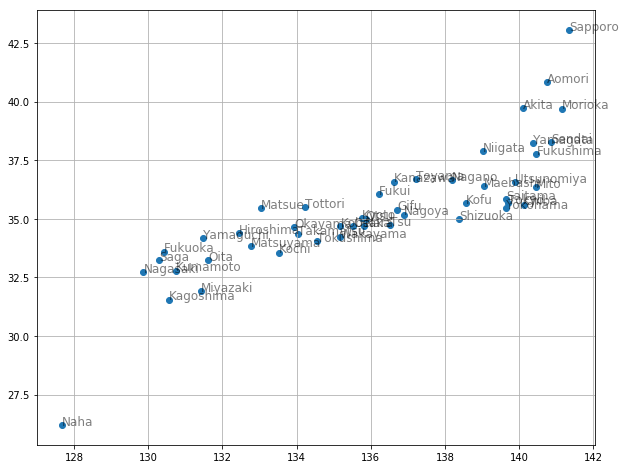

In [0]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 8))
plt.scatter(japan['Latitude'], japan['Longitude'])
for city, x, y in zip(japan['Town'], japan['Latitude'], japan['Longitude']):
    plt.text(x, y, city, alpha=0.5, size=12)
plt.grid()

# 距離行列

In [0]:
import numpy as np
from scipy.spatial import distance

mat = japan[['Latitude', 'Longitude']].values
dist_mat = distance.cdist(mat, mat, metric='euclidean')
pd.DataFrame(dist_mat, columns=japan['Town'], index=japan['Town'])

Town,Sapporo,Aomori,Morioka,Sendai,Akita,Yamagata,Fukushima,Mito,Utsunomiya,Maebashi,...,Matsuyama,Kochi,Fukuoka,Saga,Nagasaki,Kumamoto,Oita,Miyazaki,Kagoshima,Naha
Town,,,,,,,,,,,,,,,,,,,,,
Sapporo,0.000000,2.320510,3.366180,4.818748,3.569510,4.922875,5.386402,6.782791,6.661063,7.053795,...,12.597029,12.305355,14.453028,14.777968,15.431408,14.766045,13.831549,14.928418,15.771475,21.696398
Aomori,2.320510,0.000000,1.194327,2.558954,1.276427,2.611191,3.086468,4.492636,4.343865,4.740678,...,10.599151,10.234464,12.595344,12.899512,13.541060,12.826665,11.868632,12.893307,13.765775,19.597025
Morioka,3.366180,1.194327,0.000000,1.461894,1.050107,1.662319,2.070129,3.435509,3.384634,3.917619,...,10.232003,9.789432,12.345213,12.627635,13.252906,12.497490,11.524536,12.464707,13.362484,19.065372
Sendai,4.818748,2.558954,1.461894,0.000000,1.641257,0.509398,0.657717,1.973857,1.969063,2.608865,...,9.236057,8.721472,11.446507,11.704028,12.307710,11.517104,10.537859,11.388021,12.303722,17.870493
Akita,3.569510,1.276427,1.050107,1.641257,0.000000,1.500888,2.002212,3.394712,3.160369,3.486737,...,9.400055,9.006392,11.451970,11.745677,12.380038,11.646229,10.680713,11.673702,12.556062,18.349549
Yamagata,4.922875,2.611191,1.662319,0.509398,1.500888,0.000000,0.501556,1.900998,1.742083,2.262072,...,8.778837,8.281877,10.971961,11.234066,11.842233,11.058390,10.079783,10.953334,11.864631,17.478928
Fukushima,5.386402,3.086468,2.070129,0.657717,2.002212,0.501556,0.000000,1.408768,1.320422,1.956039,...,8.636594,8.104063,10.870436,11.120313,11.717050,10.917948,9.938490,10.764970,11.683971,17.222452
Mito,6.782791,4.492636,3.435509,1.973857,3.394712,1.900998,1.408768,0.000000,0.606143,1.386732,...,8.077104,7.454036,10.394866,10.608374,11.168063,10.334476,9.363398,10.051763,10.983789,16.295826
Utsunomiya,6.661063,4.343865,3.384634,1.969063,3.160369,1.742083,1.320422,0.606143,0.000000,0.841127,...,7.621014,7.027870,9.917405,10.142253,10.714522,9.891111,8.915454,9.655738,10.584017,16.002889


# ２点間の直線を引くために座標を得る関数

In [0]:
def get_edges(routes):
    edges = []
    for route in routes:
        town1, y1, x1 = [value for value in japan.values][route[0]]
        town2, y2, x2 = [value for value in japan.values][route[1]]
        edges.append([[x1, x2], [y1, y2]])
    return edges

In [0]:
get_edges([[1, 2], [3, 4], [5, 6]])

[[[140.74, 141.1525], [40.82444, 39.70361]],
 [[140.87194, 140.1025], [38.26889, 39.71861]],
 [[140.36333, 140.46778], [38.240559999999995, 37.75]]]

# 深さ優先探索

## 隣接リストを得る関数１

In [0]:
def neighbor(town, dist_mat=dist_mat, threshold=1):
    return [x[0] for x in enumerate(np.where(dist_mat[town] <= threshold, True, False)) if x[1]]

In [0]:
neighbor(12) # 東京から距離１以内の都市

[7, 8, 9, 10, 11, 12, 13]

## グラフ探索関数１

In [0]:
def traverse(i=0):
    if len(stack) != 0:
        next_town, current_town = stack.pop()
        current_direction = [[next_town, current_town]]
        if next_town not in visited_towns:
            used_routes.append([next_town, current_town])
            visited_towns.append(next_town)
            for nei in neighbor(next_town):
                if nei not in visited_towns:
                    stack.append([nei, next_town])
    return current_direction

## 深さ優先探索アニメーション１

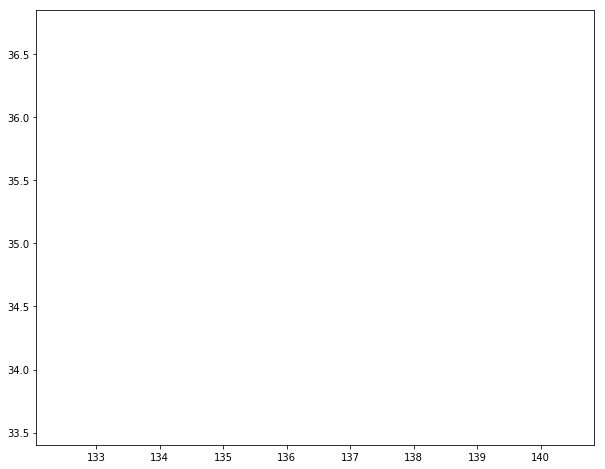

In [0]:
# -*- coding: UTF-8 -*-
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 8))

stack = [[12, 12]]
visited_towns = []
used_routes = []
current_direction = []
ims = []
i = 0
while len(stack) > 0:
    if i != 0:
        current_direction = traverse()
    image = []
    for edge in get_edges(stack):
        image += plt.plot(edge[0], edge[1], 'r', alpha=0.5)
    for edge in get_edges(current_direction):
        image += plt.plot(edge[0], edge[1], 'b', lw=5, alpha=0.5)
    for edge in get_edges(used_routes):
        image += plt.plot(edge[0], edge[1], 'k', lw=2)
    for city, x, y in zip(japan['Town'], japan['Latitude'], japan['Longitude']):
        image.append(plt.text(x, y, city, alpha=0.5, size=12))
    if len(current_direction) > 0:
        current_town = current_direction[0][0]
        image += plt.plot(japan.iloc[current_town, :]['Latitude'], 
                          japan.iloc[current_town, :]['Longitude'], markersize=20, marker='o')
    ims.append(image)
    i += 1

# アニメーション作成
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000)

ani.save("Random.gif", writer='pillow')
HTML(ani.to_jshtml())

## 隣接リストを得る関数２

In [0]:
import numpy as np
def neighbor(town, dist_mat=dist_mat, threshold=1):
    return np.argsort(dist_mat[town])[1:np.where(dist_mat[town] <= threshold, 1, 0).sum()][::-1]

## 深さ優先探索アニメーション２

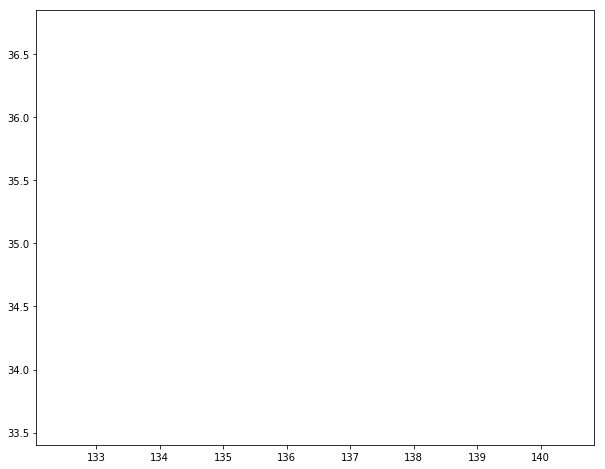

In [0]:
# -*- coding: UTF-8 -*-
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 8))

stack = [[12, 12]]
visited_towns = []
used_routes = []
current_direction = []
ims = []
i = 0
while len(stack) > 0:
    if i != 0:
        current_direction = traverse()
    image = []
    for edge in get_edges(stack):
        image += plt.plot(edge[0], edge[1], 'r', alpha=0.5)
    for edge in get_edges(current_direction):
        image += plt.plot(edge[0], edge[1], 'b', lw=5, alpha=0.5)
    for edge in get_edges(used_routes):
        image += plt.plot(edge[0], edge[1], 'k', lw=2)
    for city, x, y in zip(japan['Town'], japan['Latitude'], japan['Longitude']):
        image.append(plt.text(x, y, city, alpha=0.5, size=12))
    if len(current_direction) > 0:
        current_town = current_direction[0][0]
        image += plt.plot(japan.iloc[current_town, :]['Latitude'], 
                          japan.iloc[current_town, :]['Longitude'], markersize=20, marker='o')
    ims.append(image)
    i += 1

# アニメーション作成
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000)

ani.save("Random.gif", writer='pillow')
HTML(ani.to_jshtml())

# 幅優先探索

## グラフ探索関数２

In [0]:
def traverse(i=0):
    if len(stack) != 0:
        next_town, current_town = stack.pop(0) # 変更点
        current_direction = [[next_town, current_town]]
        if next_town not in visited_towns:
            used_routes.append([next_town, current_town])
            visited_towns.append(next_town)
            for nei in neighbor(next_town):
                if nei not in visited_towns:
                    stack.append([nei, next_town])
    return current_direction

## 隣接リストを得る関数３

In [0]:
import numpy as np
def neighbor(town, dist_mat=dist_mat, threshold=1):
    return np.argsort(dist_mat[town])[1:np.where(dist_mat[town] <= threshold, 1, 0).sum()] # 末尾だけ変更

## 幅優先探索アニメーション

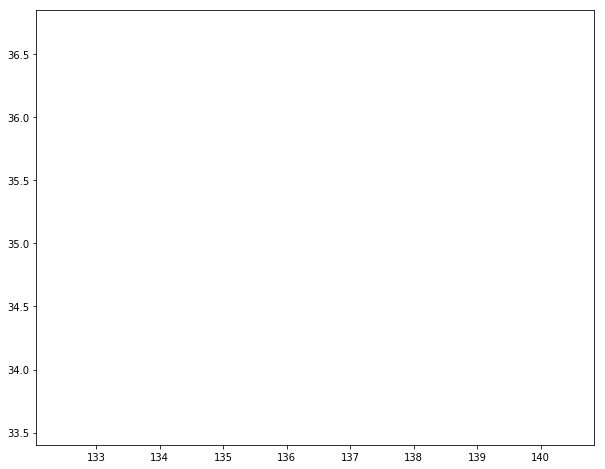

In [0]:
# -*- coding: UTF-8 -*-
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 8))

stack = [[12, 12]]
visited_towns = []
used_routes = []
current_direction = []
ims = []
i = 0
while len(stack) > 0:
    if i != 0:
        current_direction = traverse()
    image = []
    for edge in get_edges(stack):
        image += plt.plot(edge[0], edge[1], 'r', alpha=0.5)
    for edge in get_edges(current_direction):
        image += plt.plot(edge[0], edge[1], 'b', lw=5, alpha=0.5)
    for edge in get_edges(used_routes):
        image += plt.plot(edge[0], edge[1], 'k', lw=2)
    for city, x, y in zip(japan['Town'], japan['Latitude'], japan['Longitude']):
        image.append(plt.text(x, y, city, alpha=0.5, size=12))
    if len(current_direction) > 0:
        current_town = current_direction[0][0]
        image += plt.plot(japan.iloc[current_town, :]['Latitude'], 
                          japan.iloc[current_town, :]['Longitude'], markersize=20, marker='o')
    ims.append(image)
    i += 1

# アニメーション作成
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000)

ani.save("Random.gif", writer='pillow')
HTML(ani.to_jshtml())

# 最良優先探索と最小木

## スタックを並び直す関数

In [0]:
def sort_stack(stack):
    return [stack[i] for i in np.argsort([dist_mat[edge[0]][edge[1]] for edge in stack])]

## 最良優先探索アニメーション

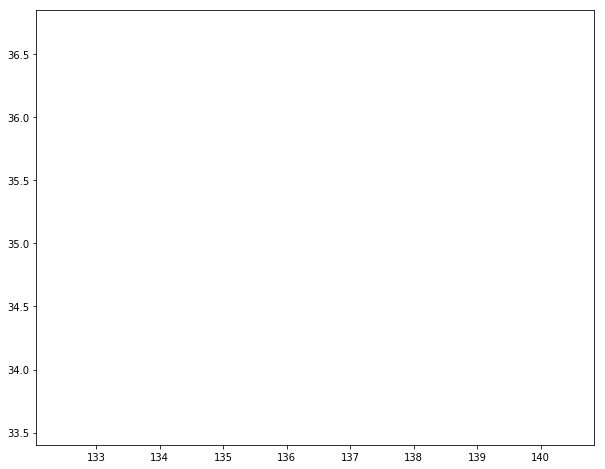

In [0]:
# -*- coding: UTF-8 -*-
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 8))

stack = [[12, 12]]
visited_towns = []
used_routes = []
current_direction = []
ims = []
i = 0
while len(stack) > 0:
    stack = sort_stack(stack) # これを追加しただけ
    if i != 0:
        current_direction = traverse()
    image = []
    for edge in get_edges(stack):
        image += plt.plot(edge[0], edge[1], 'r', alpha=0.5)
    for edge in get_edges(current_direction):
        image += plt.plot(edge[0], edge[1], 'b', lw=5, alpha=0.5)
    for edge in get_edges(used_routes):
        image += plt.plot(edge[0], edge[1], 'k', lw=2)
    for city, x, y in zip(japan['Town'], japan['Latitude'], japan['Longitude']):
        image.append(plt.text(x, y, city, alpha=0.5, size=12))
    if len(current_direction) > 0:
        current_town = current_direction[0][0]
        image += plt.plot(japan.iloc[current_town, :]['Latitude'], 
                          japan.iloc[current_town, :]['Longitude'], markersize=20, marker='o')
    ims.append(image)
    i += 1

# アニメーション作成
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000)

ani.save("Random.gif", writer='pillow')
HTML(ani.to_jshtml())